In [8]:
#!/usr/bin/env python

# --------------------------------------------------------
# Faster R-CNN
# Copyright (c) 2015 Microsoft
# Licensed under The MIT License [see LICENSE for details]
# Written by Ross Girshick
# --------------------------------------------------------

"""
Demo script showing detections in sample images.

See README.md for installation instructions before running.
"""

import _init_paths
from fast_rcnn.config import cfg
from fast_rcnn.test import im_detect
from fast_rcnn.nms_wrapper import nms
from utils.timer import Timer
import matplotlib.pyplot as plt
import numpy as np
import scipy.io as sio
import caffe, os, sys, cv2
import argparse
%matplotlib inline



In [15]:

CLASSES = ('__background__',
           'pedestrian')

NETS = {'vgg16': ('VGG16',
                  'VGG16_faster_rcnn_final.caffemodel'),
        'zf': ('ZF',
                  'ZF_faster_rcnn_final.caffemodel')}


def vis_detections(im, class_name, dets, thresh=0.5):
    """Draw detected bounding boxes."""
    inds = np.where(dets[:, -1] >= thresh)[0]
    if len(inds) == 0:
        return

    im = im[:, :, (2, 1, 0)]
    fig, ax = plt.subplots(figsize=(12, 12))
    ax.imshow(im, aspect='equal')
    for i in inds:
        bbox = dets[i, :4]
        score = dets[i, -1]

        ax.add_patch(
            plt.Rectangle((bbox[0], bbox[1]),
                          bbox[2] - bbox[0],
                          bbox[3] - bbox[1], fill=False,
                          edgecolor='red', linewidth=3.5)
            )
        ax.text(bbox[0], bbox[1] - 2,
                '{:s} {:.3f}'.format(class_name, score),
                bbox=dict(facecolor='blue', alpha=0.5),
                fontsize=14, color='white')

    ax.set_title(('{} detections with '
                  'p({} | box) >= {:.1f}').format(class_name, class_name,
                                                  thresh),
                  fontsize=14)
    plt.axis('off')
    plt.tight_layout()
    plt.draw()

def demo(net, image_name):
    """Detect object classes in an image using pre-computed object proposals."""

    # Load the demo image
    im_file = os.path.join("/root/data/caltech-pedestrian-dataset-converter/data/images", image_name)
    im = cv2.imread(im_file)

    # Detect all object classes and regress object bounds
    timer = Timer()
    timer.tic()
    scores, boxes = im_detect(net, im)
    timer.toc()
    print ('Detection took {:.3f}s for '
           '{:d} object proposals').format(timer.total_time, boxes.shape[0])

    # Visualize detections for each class
    CONF_THRESH = 0.9
    NMS_THRESH = 0.3
    for cls_ind, cls in enumerate(CLASSES[1:]):
        cls_ind += 1 # because we skipped background
        cls_boxes = boxes[:, 4*cls_ind:4*(cls_ind + 1)]
        cls_scores = scores[:, cls_ind]
        dets = np.hstack((cls_boxes,
                          cls_scores[:, np.newaxis])).astype(np.float32)
        keep = nms(dets, NMS_THRESH)
        dets = dets[keep, :]
        vis_detections(im, cls, dets, thresh=CONF_THRESH)

def parse_args():
    """Parse input arguments."""
    parser = argparse.ArgumentParser(description='Faster R-CNN demo')
    parser.add_argument('--gpu', dest='gpu_id', help='GPU device id to use [0]',
                        default=0, type=int)
    parser.add_argument('--cpu', dest='cpu_mode',
                        help='Use CPU mode (overrides --gpu)',
                        action='store_true')
    parser.add_argument('--net', dest='demo_net', help='Network to use [vgg16]',
                        choices=NETS.keys(), default='vgg16')

    args = parser.parse_args()

    return args


In [12]:
    parser = argparse.ArgumentParser(description='Faster R-CNN demo')
    parser.add_argument('--gpu', dest='gpu_id', help='GPU device id to use [0]',
                        default=0, type=int)
    parser.add_argument('--cpu', dest='cpu_mode',
                        help='Use CPU mode (overrides --gpu)',
                        action='store_true')
    parser.add_argument('--net', dest='demo_net', help='Network to use [vgg16]',
                        choices=NETS.keys(), default='vgg16')




_StoreAction(option_strings=['--net'], dest='demo_net', nargs=None, const=None, default='vgg16', type=None, choices=['vgg16', 'zf'], help='Network to use [vgg16]', metavar=None)



Loaded network /root/py-faster-rcnn/output/faster_rcnn_end2end/caltech_pedestrian_trainval/vgg16_faster_rcnn_iter_50000.caffemodel
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo/set10_V010_1134.jpg
Detection took 0.575s for 300 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo/set08_V000_1613.jpg
Detection took 0.484s for 300 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo/set07_V000_727.jpg
Detection took 0.459s for 300 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo/set09_V000_1722.jpg
Detection took 0.503s for 300 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo/set10_V005_1516.jpg
Detection took 0.450s for 300 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo/set06_V014_348.jpg
Detection took 0.547s for 300 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo/set06_V006_841.jpg
Detection took 0.464s for 300 object proposals
~~~~~~~~~~~~~~~~

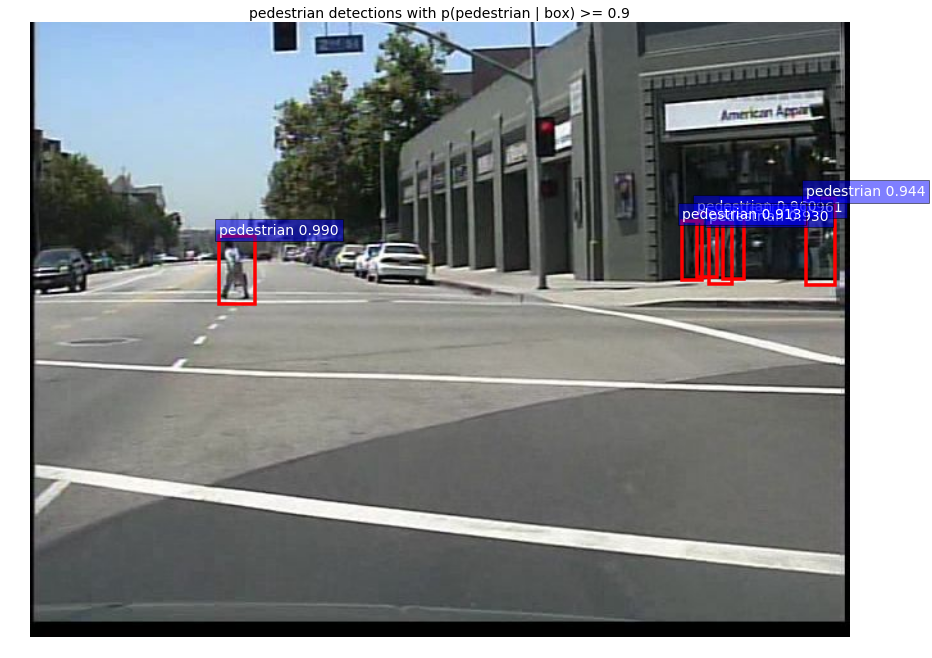

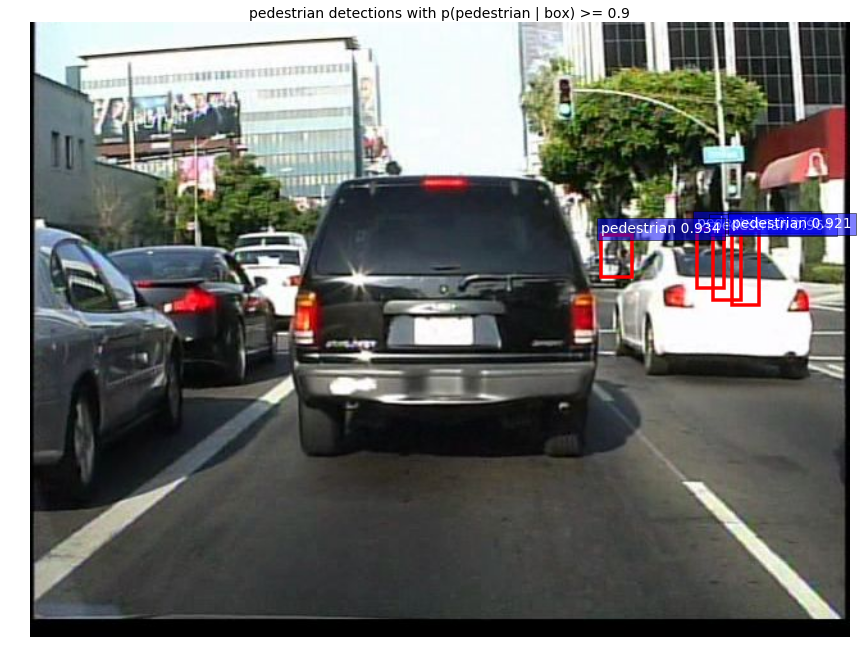

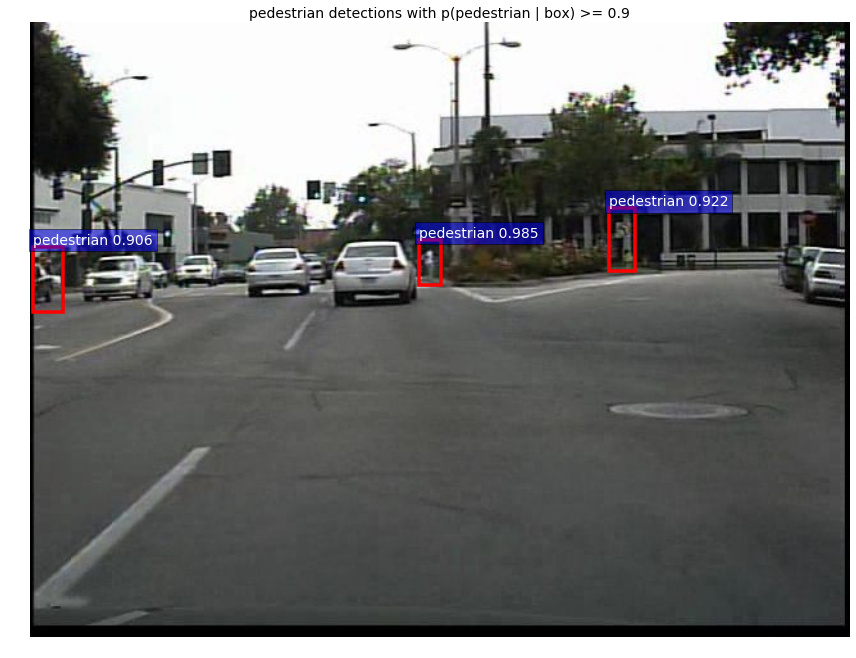

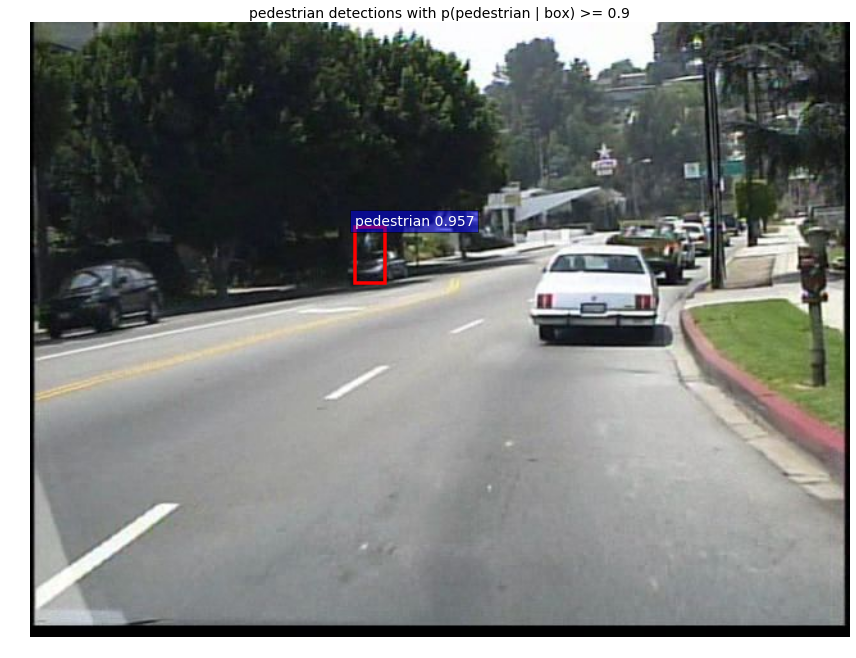

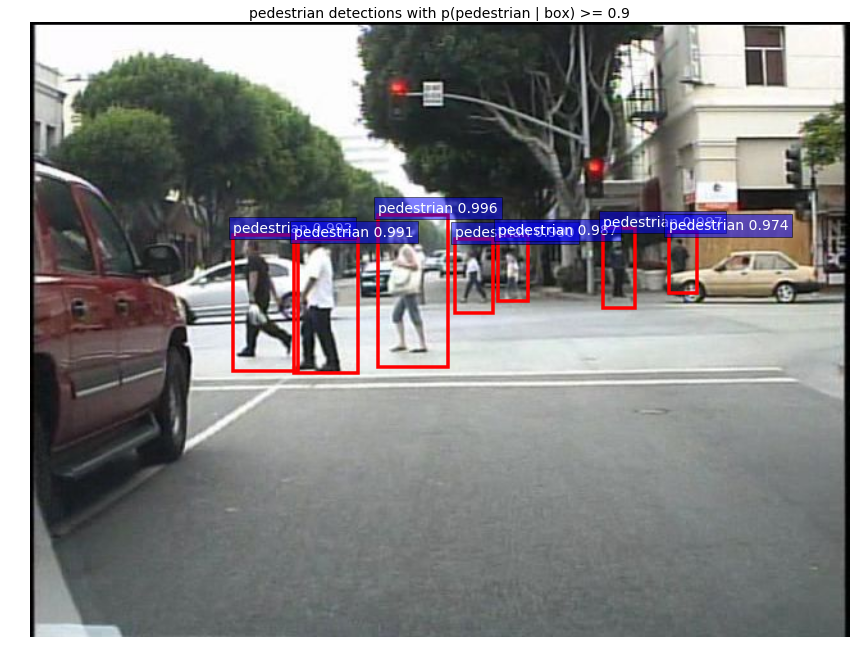

...

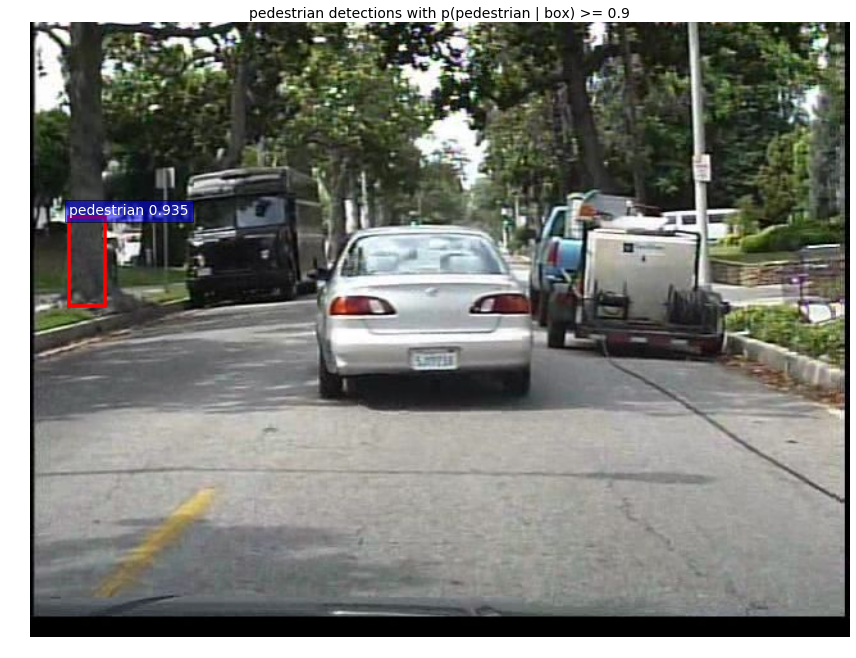

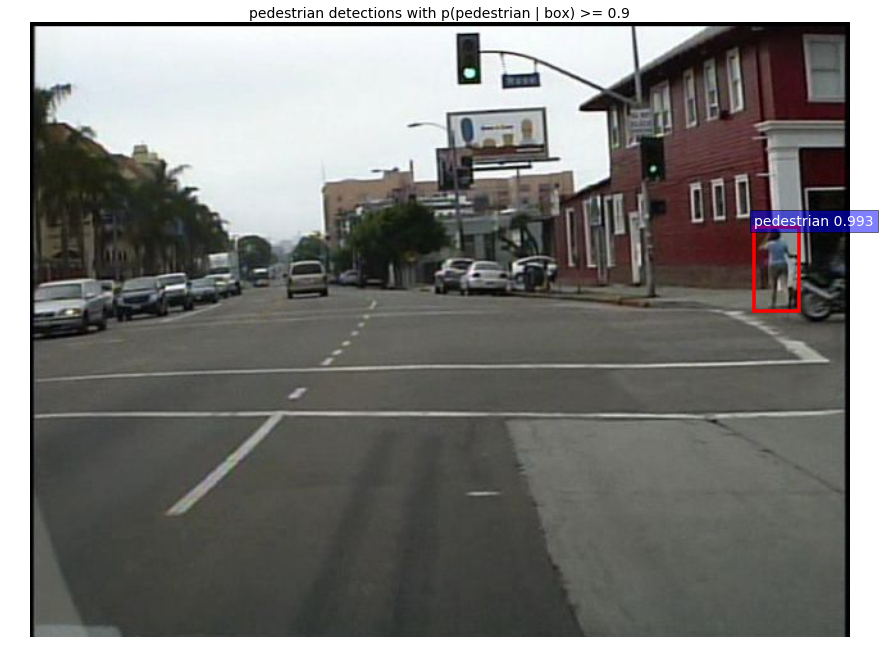

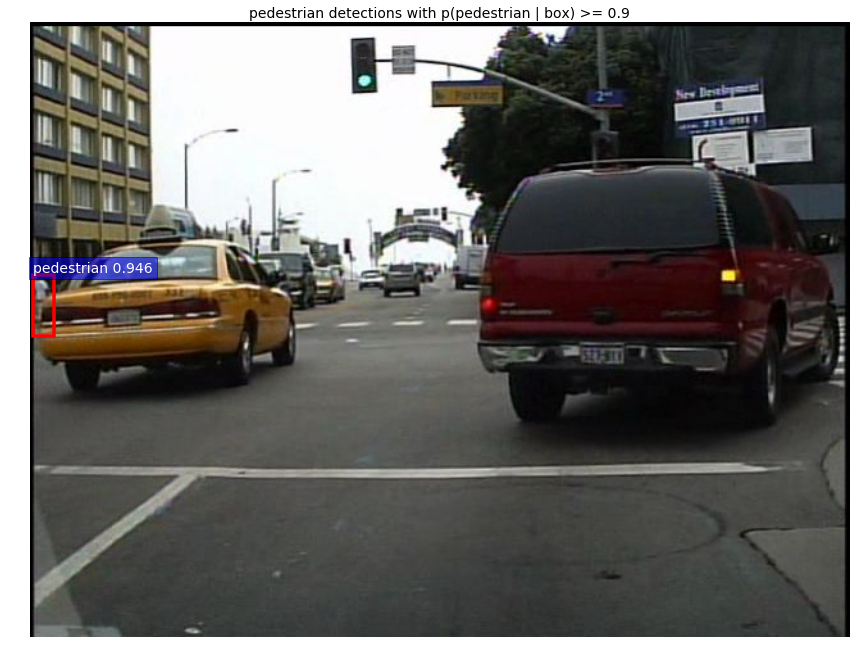

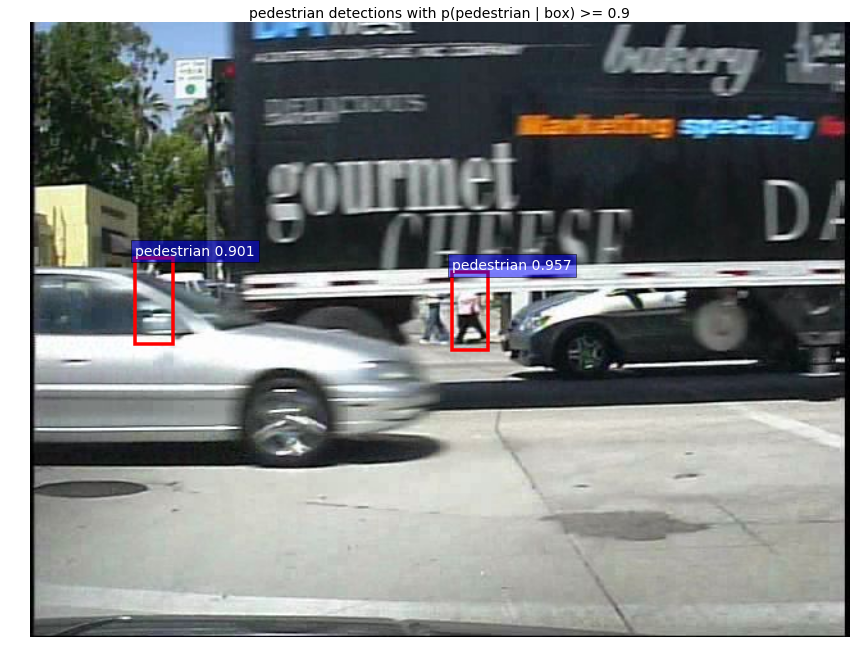

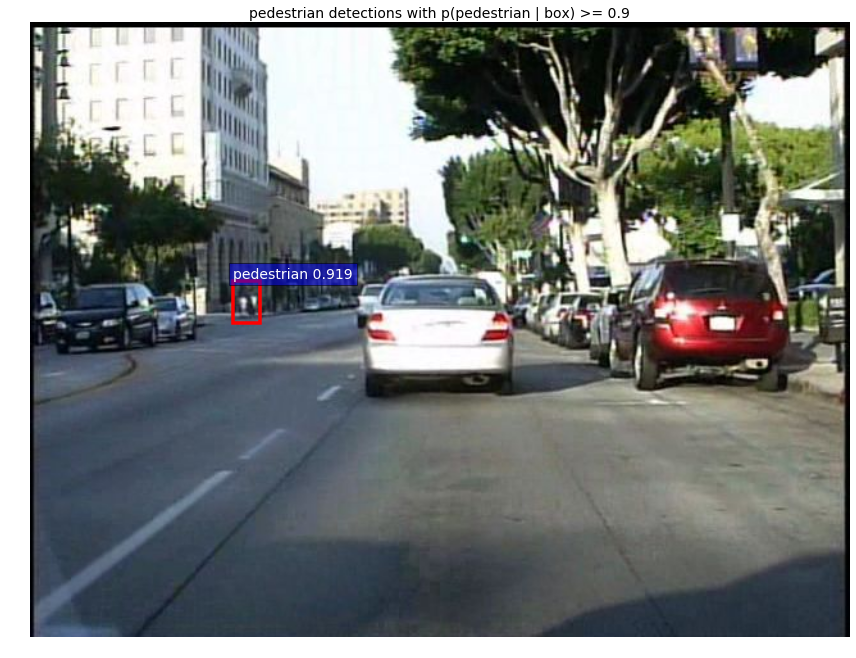

In [18]:
if __name__ == '__main__':
    sys.argv = ['./tools/demo.py', '--gpu', '2']

    
    cfg.TEST.HAS_RPN = True  # Use RPN for proposals

    args = parse_args()



    prototxt = '/root/py-faster-rcnn/models/caltech/VGG16/faster_rcnn_end2end/test.prototxt'
    caffemodel = "/root/py-faster-rcnn/output/faster_rcnn_end2end/caltech_pedestrian_trainval/vgg16_faster_rcnn_iter_50000.caffemodel"

    if not os.path.isfile(caffemodel):
        raise IOError(('{:s} not found.\nDid you run ./data/script/'
                       'fetch_faster_rcnn_models.sh?').format(caffemodel))

    if args.cpu_mode:
        caffe.set_mode_cpu()
    else:
        caffe.set_mode_gpu()
        caffe.set_device(args.gpu_id)
        cfg.GPU_ID = args.gpu_id
    net = caffe.Net(prototxt, caffemodel, caffe.TEST)

    print '\n\nLoaded network {:s}'.format(caffemodel)

    # Warmup on a dummy image
    im = 128 * np.ones((300, 500, 3), dtype=np.uint8)
    for i in xrange(2):
        _, _= im_detect(net, im)
        
    f = open("test_pedestrian.txt")
    im_names = [line.strip()  for line in f]
    
   
    for im_name in im_names:
        set_num, v_num, frame_num = im_name.split("_")
        set_num = int(set_num[-2:])
        if set_num < 6:
            continue
        print '~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~'
        print 'Demo for data/demo/{}'.format(im_name)
        demo(net, im_name)

    plt.show()
    


In [ ]:
prototxt = '/root/py-faster-rcnn/models/caltech/VGG16/faster_rcnn_end2end/faster_rcnn_test.pt'

In [ ]:
    for im_name in im_names:
        print '~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~'
        print 'Demo for data/demo/{}'.format(im_name)
        demo(net, im_name)

    plt.show()

In [ ]:
mv ../data/demo/12065662_867092440052640_8182542809320736756_n.jpg ../data/demo/yicheng.jpg